#### Notes & Methodology

Try running cell by cell, some steps take a while so don't get stuck waiting if you just want to run a quick sim

Processing Analysis should tell us info on how fast our micro controller or hardware setup is, good resource to run in actual hardware

A Fan consist of 1 Imager object and at least 1 Blade object, the Blade has LED info such as position and value, the Imager handles mapping between real space and image space

Fan instantiates both and pairs them to work together, Fan handles LED data update operation for each blade based on a **user defined Update Interval**

The update interval is independent of Fan frequency, it is up to us to determine the best value here depeding on combination of number of fan blades, LEDs, and processing power 
but generally that means a smaller update interval means value updates more often, which means more required processing power

The Fan object works by taking some **delta time** and calculating new Blade positions based on parameters like the set fan frequency and number of blades, etc..., 
and then using an Imager to find the corresponding RGB value for every LED available

In theory, I have this set up such that the final operation loop should consist of updating values at a constant polling time of our choice (the update interval)

#### Load Packages and add Dirs to Path

In [1]:
from pathlib import Path
import sys
import os
root = Path(os.path.abspath('')).parent
if str(root) not in sys.path:
    sys.path.append(str(root))
if str(root.parent) not in sys.path:
    sys.path.append(str(root.parent))

import numpy as np
import cv2 as cv
import matplotlib.pyplot as plt

from ipywidgets import IntProgress
from IPython.display import display

from misc.load_misc import *
from classes.blade import Blade
from classes.imager import Imager
from classes.fan import Fan

# Simulation

Fan Parameters Updated


IntProgress(value=0, description='Processing...', max=3)

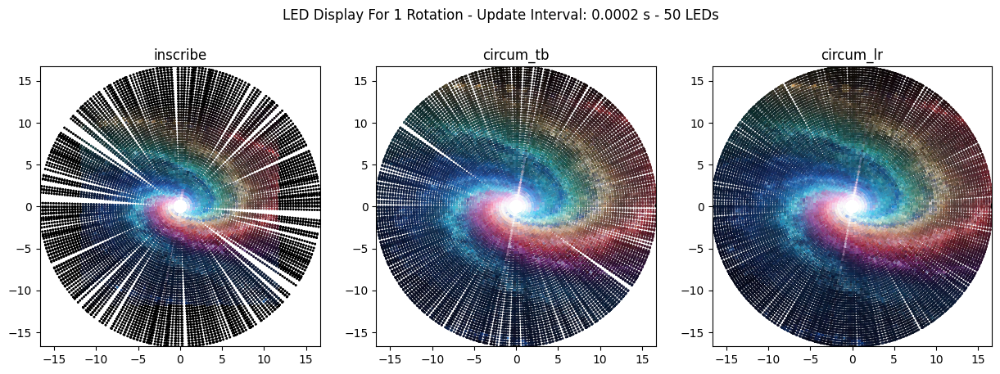

In [2]:
%matplotlib inline

#Parameters
nleds = 50 #Num LEDs per blade, spaced evenly along blade
nblades = 2 #Will space out evenly around center
fan_freq = 24 #Rotations per sec
interval = .0002 #seconds #How often to update LED positions
img_path = './images/space_square.jpg'

#Instantiate
F = Fan(nleds=nleds, nblades=nblades, freq=fan_freq, img_path=img_path)

#Run Sim
modes = ['inscribe', 'circum_tb', 'circum_lr']

fig, axes = plt.subplots(nrows=1, ncols=len(modes), figsize=(len(modes)*5,5))
loadbar = IntProgress(min=0, max=len(modes), description='Processing...')
display(loadbar)

for i,mode in enumerate(modes):
    F.mode = mode #Refer to Imager for modes
    F.update_params(quiet=True) #Always run update_params to reinstantiate blades and imager
    F.run_sim(interval=interval, title=mode, ax=axes[i], marker_size=1)
    loadbar.value = i + 1

fig.suptitle(f'LED Display For 1 Rotation - Update Interval: {interval} s - {nleds} LEDs')
plt.show()


# Processing Analysis

Processing time is very dependent on current setup, this section is designed to analyze the performance of the current machine for a variety of scenarios

Find data on the following's impact on performance:
- number of LEDs per blade
- number of blades vs processing interval i.e. better to have more blades with less LED updates, or less blades with faster LED updates

Things to consider:
- Image resolution only impacts initial conversion, per loop processing time relies on determining LED position in real space via trig and then mapping to value onto image spacing via a conversion factor

- Any lists that involve math are numpy arrays to improve speed, allows in place mathematical manipulation i.e. 2*[1,2,3,4] = [2,4,6,8], so no iteration (**CRITICAL**: Python's biggest drawback is list manipulation, so avoid iteration)

- Fan size should not affect calculations as they are all dependent on the number of LEDs being used which is independent of fan size

- Image output mode i.e. 'inscribed' shouldn't matter as the position calculation will always be a list multiplication, even if image is smaller than fan size, we multiply by 0 on unused LEDs

- Raspberry Pi Zero operates at 1 GHz



#### LED test

IntProgress(value=0, description='Processing...', max=300)

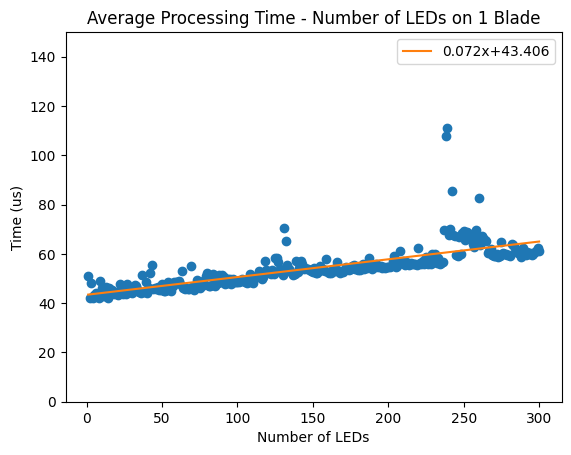

In [4]:
nleds_list = np.arange(1,301) #300 points
nblades = 1 #Will space out evenly around center
fan_freq = 24 #Rotations per sec

loadbar = IntProgress(min=0, max=nleds_list.max(), description='Processing...')
display(loadbar)

times_out = []
for nleds in nleds_list:
    with HiddenPrints(): #Blocks printing
        F = Fan(nleds=nleds, nblades=nblades, freq=fan_freq, img_path=img_path, mode='circum_tb')
    times = F.get_avg_time(run_time=1)
    times_out.append(times.mean())
    loadbar.value = nleds
times_out = np.array(times_out)

#Plot
fit_m, fit_b = np.polyfit(nleds_list, times_out*10**6, 1)
real = plt.plot(nleds_list, times_out*10**6, 'o')
fit = plt.plot(nleds_list, fit_m*nleds_list+fit_b, '-', label=f'{fit_m:.03f}x+{fit_b:.03f}') #y=mx+b
plt.legend()
plt.title('Average Processing Time - Number of LEDs on 1 Blade')
plt.xlabel('Number of LEDs')
plt.ylabel('Time (us)')
plt.ylim([0,150])
plt.show()


#### nBlades vs Update Interval

IntProgress(value=0, description='Processing...', max=50)

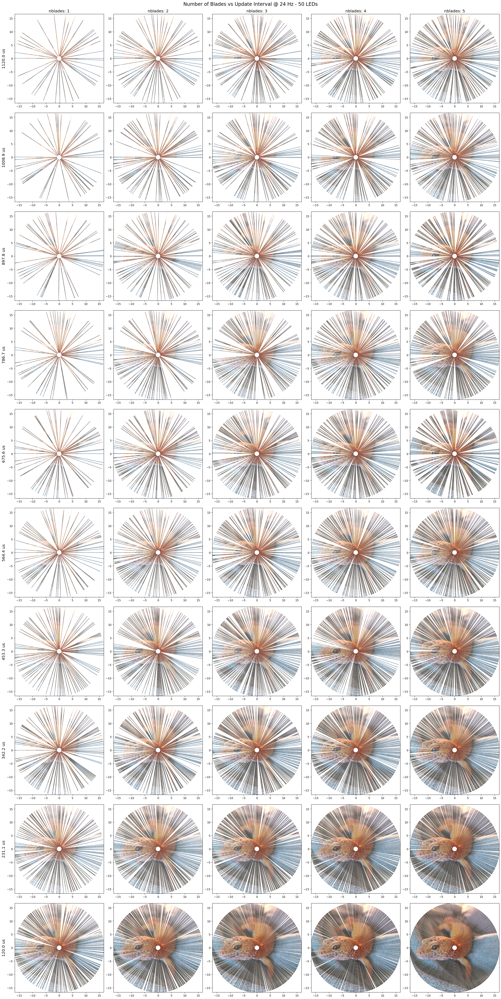

In [5]:
#Uncomment to change image
img_path = './images/fuego.jpg'

num_plots = 10 #How many intervals to test
interval_list = np.linspace(.000120, .001120, num_plots)[::-1] #seconds
nblades_list = np.arange(1,6) #5 Blades max
freq= 24
nleds = 50

fig, axes = plt.subplots(nrows=len(interval_list), ncols=len(nblades_list), figsize=(len(nblades_list)*5, len(interval_list)*5), constrained_layout=True)
loadbar = IntProgress(min=0, max=len(interval_list)*len(nblades_list), description='Processing...')
display(loadbar)

for i,interval in enumerate(interval_list):
    for j,nblades in enumerate(nblades_list):
        with HiddenPrints(): #Blocks printing
            F = Fan(nleds=nleds, nblades=nblades, freq=freq, img_path=img_path, mode='circum_tb')
            F.run_sim(interval=interval, ax=axes[i,j], marker_size=1)
            loadbar.value += 1

fig.suptitle(f'Number of Blades vs Update Interval @ {freq} Hz - {nleds} LEDs', size='xx-large')
cols = [f'nblades: {i}' for i in nblades_list]
rows = [f'{i:.1f} us' for i in interval_list*10**6]

for ax, col in zip(axes[0], cols):
    ax.set_title(col, size='x-large')

for ax, row in zip(axes[:,0], rows):
    ax.set_ylabel(row, rotation=90, size='x-large')


plt.show()
